In [50]:
import pandas as pd
import numpy as np
import requests 
from bs4 import BeautifulSoup
import matplotlib.pyplot as plt
import seaborn as sns

# Data Scraping and Collection

In [73]:
url="https://fbref.com/en/comps/Big5/stats/players/Big-5-European-Leagues-Stats"

In [74]:
page=requests.get(url)
page

<Response [200]>

In [75]:
soup=BeautifulSoup(page.text,'html')
soup


<!DOCTYPE html>

<html class="no-js" data-root="/home/fb/deploy/www/base" data-version="klecko-" lang="en">
<head>
<meta charset="utf-8"/>
<meta content="ie=edge" http-equiv="x-ua-compatible"/>
<meta content="width=device-width, initial-scale=1.0, maximum-scale=2.0" name="viewport">
<link href="https://cdn.ssref.net/req/202502121" rel="dns-prefetch"/>
<script>
/* https://docs.osano.com/hc/en-us/articles/22469433444372-Google-Consent-Mode-v2  */
  window.dataLayer = window.dataLayer ||[];
      function gtag(){dataLayer.push(arguments);}
      gtag('consent','default',{
        'ad_storage':'denied',
        'analytics_storage':'denied',
        'ad_user_data':'denied',
        'ad_personalization':'denied',
        'personalization_storage':'denied',
        'functionality_storage':'granted',
        'security_storage':'granted',
        'wait_for_update': 500
      });
      gtag("set", "ads_data_redaction", true);
</script>
<script src="https://cmp.osano.com/16CGnCU8UtNhM14sg/126698

In [76]:
table=soup.find_all("table")[0]
table

<table class="min_width sortable stats_table min_width shade_zero" data-cols-to-freeze="1,2" data-non-qual="1" data-qual-label=" When table is sorted, hide non-qualifiers for rate stats" data-qual-text="" id="stats_standard">
<caption>Player Standard Stats <span style="color: #666; font-size:smaller">2024-2025 Big 5 European Leagues</span> Table</caption>
<colgroup><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/><col/></colgroup>
<thead>
<tr class="over_header">
<th aria-label="" class="over_header center" colspan="8" data-stat=""></th>
<th aria-label="" class="over_header center group_start" colspan="4" data-stat="header_playing">Playing Time</th>
<th aria-label="" class="over_header center group_start" colspan="8" data-stat="header_performance">Performance</th>
<th aria-label="" class="over_header center group_st

In [77]:
head=table.find_all('th')[:34]
head

[<th aria-label="" class="over_header center" colspan="8" data-stat=""></th>,
 <th aria-label="" class="over_header center group_start" colspan="4" data-stat="header_playing">Playing Time</th>,
 <th aria-label="" class="over_header center group_start" colspan="8" data-stat="header_performance">Performance</th>,
 <th aria-label="" class="over_header center group_start" colspan="4" data-stat="header_expected">Expected</th>,
 <th aria-label="" class="over_header center group_start" colspan="3" data-stat="header_progression">Progression</th>,
 <th aria-label="" class="over_header center group_start" colspan="10" data-stat="header_per90">Per 90 Minutes</th>,
 <th></th>,
 <th aria-label="Rk" class="tooltip ranker poptip sort_default_asc show_partial_when_sorting center" data-stat="ranker" data-tip="&lt;strong&gt;Rank&lt;/strong&gt;&lt;br&gt;This is a count of the rows from top to bottom.&lt;br&gt;It is recalculated following the sorting of a column." scope="col">Rk</th>,
 <th aria-label="Pla

In [78]:
header=[x.text.strip() for x in head][7:]
header

['Rk',
 'Player',
 'Nation',
 'Pos',
 'Squad',
 'Comp',
 'Age',
 'Born',
 'MP',
 'Starts',
 'Min',
 '90s',
 'Gls',
 'Ast',
 'G+A',
 'G-PK',
 'PK',
 'PKatt',
 'CrdY',
 'CrdR',
 'xG',
 'npxG',
 'xAG',
 'npxG+xAG',
 'PrgC',
 'PrgP',
 'PrgR']

In [79]:
df=pd.DataFrame(columns=header)
df

,Rk,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,...,PKatt,CrdY,CrdR,xG,npxG,xAG,npxG+xAG,PrgC,PrgP,PrgR


In [80]:
body=table.find_all("tr")
body

[<tr class="over_header">
 <th aria-label="" class="over_header center" colspan="8" data-stat=""></th>
 <th aria-label="" class="over_header center group_start" colspan="4" data-stat="header_playing">Playing Time</th>
 <th aria-label="" class="over_header center group_start" colspan="8" data-stat="header_performance">Performance</th>
 <th aria-label="" class="over_header center group_start" colspan="4" data-stat="header_expected">Expected</th>
 <th aria-label="" class="over_header center group_start" colspan="3" data-stat="header_progression">Progression</th>
 <th aria-label="" class="over_header center group_start" colspan="10" data-stat="header_per90">Per 90 Minutes</th><th></th>
 </tr>,
 <tr>
 <th aria-label="Rk" class="tooltip ranker poptip sort_default_asc show_partial_when_sorting center" data-stat="ranker" data-tip="&lt;strong&gt;Rank&lt;/strong&gt;&lt;br&gt;This is a count of the rows from top to bottom.&lt;br&gt;It is recalculated following the sorting of a column." scope="col

In [96]:
for row in body[2:]:
    row_data=row.find_all('td')[:26]
    row_indi_data=[x.text.strip() for x in row_data]
    row_data_th=row.find_all('th')
    row_indi_data_th=[x.text.strip() for x in row_data_th]
    row_indi_data.insert(0,row_indi_data_th[0])
    # print(len(row_indi_data))
    # print(row_indi_data)
    if len(row_indi_data)==27:
        l=len(df)
        df.loc[l]=row_indi_data

In [97]:
df

,Rk,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,...,PKatt,CrdY,CrdR,xG,npxG,xAG,npxG+xAG,PrgC,PrgP,PrgR
0,1,Max Aarons,eng ENG,DF,Bournemouth,eng Premier League,25-041,2000,3,1,...,0,0,0,0.0,0.0,0.0,0.0,1,8,3
1,2,Max Aarons,eng ENG,MF,Valencia,es La Liga,25-041,2000,1,0,...,0,0,0,0.0,0.0,0.0,0.0,0,2,3
2,3,Rodrigo Abajas,es ESP,DF,Valencia,es La Liga,21-278,2003,1,1,...,0,1,0,0.1,0.1,0.0,0.1,3,2,3
3,4,James Abankwah,ie IRL,"DF,MF",Udinese,it Serie A,21-029,2004,6,0,...,0,1,0,0.1,0.1,0.0,0.1,3,4,1
4,5,Keyliane Abdallah,fr FRA,FW,Marseille,fr Ligue 1,18-315,2006,1,0,...,0,0,0,0.0,0.0,0.0,0.0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2654,2655,Edhy Zuliani,it ITA,DF,Toulouse,fr Ligue 1,20-187,2004,1,0,...,0,0,0,0.0,0.0,0.0,0.0,0,0,0
2655,2656,Szymon Żurkowski,pl POL,MF,Empoli,it Serie A,27-142,1997,3,0,...,0,0,0,0.1,0.1,0.0,0.1,1,1,2
2656,2657,Martin Ødegaard,no NOR,MF,Arsenal,eng Premier League,26-059,1998,16,15,...,1,2,0,3.1,2.3,2.4,4.7,40,139,80
2657,2658,Milan Đurić,ba BIH,FW,Monza,it Serie A,34-268,1990,18,13,...,0,3,0,2.9,2.9,1.1,4.0,2,21,30


# Data Cleaning

In [98]:
df['Nation'].unique()

array(['eng ENG', 'es ESP', 'ie IRL', 'fr FRA', 'ma MAR', 'dz ALG',
       'eg EGY', 'tn TUN', 'sa KSA', 'dk DEN', 'br BRA', 'it ITA',
       'ng NGA', 'sct SCO', 'us USA', 'at AUT', 'de GER', 'ci CIV',
       'me MNE', 'ch SUI', 'se SWE', 'gh GHA', 'no NOR', 'ro ROU',
       'nl NED', 'ar ARG', 'py PAR', 'ga GAB', 'pt POR', 'mx MEX',
       'sn SEN', 'pa PAN', 'pr PUR', 'jm JAM', 'uy URU', 've VEN',
       'ht HAI', 'is ISL', 'jp JPN', 'al ALB', 'co COL', 'tg TOG',
       'gn GUI', 'hr CRO', 'sl SLE', 'ca CAN', 'cd COD', 'cm CMR',
       'hu HUN', 'zm ZAM', 'cz CZE', 'be BEL', 'sr SUR', 'pl POL',
       'sk SVK', 'gw GNB', 'si SVN', 'ml MLI', 'nir NIR', 'rs SRB',
       'cl CHI', 'wls WAL', 'au AUS', 'nz NZL', 'ec ECU', 'tr TUR',
       'gm GAM', 'cg CGO', 'gq EQG', 'cv CPV', 'ge GEO', 'mq MTQ',
       'ba BIH', 'mk MKD', 'gr GRE', 'ua UKR', 'do DOM', 'cr CRC',
       'lt LTU', 'ru RUS', 'iq IRQ', 'kr KOR', 'ph PHI', 'bj BEN',
       'fi FIN', 'id IDN', 'ee EST', 'bf BFA', 'zw ZIM', '

In [99]:
df1=df.copy()

In [130]:
nation = {"eng ENG": "England","es ESP": "Spain","ie IRL": "Ireland","fr FRA": "France","ma MAR": "Morocco","dz ALG": "Algeria","eg EGY": "Egypt","tn TUN": "Tunisia","sa KSA": "Saudi Arabia","dk DEN": "Denmark","br BRA": "Brazil","it ITA": "Italy","ng NGA": "Nigeria","sct SCO": "Scotland","us USA": "United States","at AUT": "Austria","de GER": "Germany","ci CIV": "Ivory Coast","me MNE": "Montenegro","ch SUI": "Switzerland","se SWE": "Sweden","gh GHA": "Ghana","no NOR": "Norway","ro ROU": "Romania","nl NED": "Netherlands","ar ARG": "Argentina","py PAR": "Paraguay","ga GAB": "Gabon","pt POR": "Portugal","mx MEX": "Mexico","sn SEN": "Senegal","pa PAN": "Panama","pr PUR": "Puerto Rico","jm JAM": "Jamaica","uy URU": "Uruguay","ve VEN": "Venezuela","ht HAI": "Haiti","is ISL": "Iceland","jp JPN": "Japan","al ALB": "Albania","co COL": "Colombia","tg TOG": "Togo","gn GUI": "Guinea","hr CRO": "Croatia","sl SLE": "Sierra Leone","ca CAN": "Canada","cd COD": "DR Congo","cm CMR": "Cameroon","hu HUN": "Hungary","zm ZAM": "Zambia","cz CZE": "Czech Republic","be BEL": "Belgium","sr SUR": "Suriname","pl POL": "Poland","sk SVK": "Slovakia","gw GNB": "Guinea-Bissau","si SVN": "Slovenia","ml MLI": "Mali","nir NIR": "Northern Ireland","rs SRB": "Serbia","cl CHI": "Chile","wls WAL": "Wales","au AUS": "Australia","nz NZL": "New Zealand","ec ECU": "Ecuador","tr TUR": "Turkey","gm GAM": "Gambia","cg CGO": "Republic of Congo","gq EQG": "Equatorial Guinea","cv CPV": "Cape Verde","ge GEO": "Georgia","mq MTQ": "Martinique","ba BIH": "Bosnia and Herzegovina","mk MKD": "North Macedonia","gr GRE": "Greece","ua UKR": "Ukraine","do DOM": "Dominican Republic","cr CRC": "Costa Rica","lt LTU": "Lithuania","ru RUS": "Russia","iq IRQ": "Iraq","kr KOR": "South Korea","ph PHI": "Philippines","bj BEN": "Benin","fi FIN": "Finland","id IDN": "Indonesia","ee EST": "Estonia","bf BFA": "Burkina Faso","zw ZIM": "Zimbabwe","il ISR": "Israel","cy CYP": "Cyprus","uz UZB": "Uzbekistan","ao ANG": "Angola","cf CTA": "Central African Republic","gp GLP": "Guadeloupe","mg MAD": "Madagascar","pe PER": "Peru","gf GUF": "French Guiana","mz MOZ": "Mozambique","am ARM": "Armenia","xk KVX": "Kosovo","ly LBY": "Libya","bi BDI": "Burundi","ke KEN": "Kenya","km COM": "Comoros","ms MSR": "Montserrat","lu LUX": "Luxembourg","jo JOR": "Jordan","ir IRN": "Iran","mt MLT": "Malta"}
df['Nation']=df['Nation'].replace(nation)
df

,Rk,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,...,PKatt,CrdY,CrdR,xG,npxG,xAG,npxG+xAG,PrgC,PrgP,PrgR
0,1,Max Aarons,England,DF,Bournemouth,eng Premier League,25-041,2000,3,1,...,0,0,0,0.0,0.0,0.0,0.0,1,8,3
1,2,Max Aarons,England,MF,Valencia,es La Liga,25-041,2000,1,0,...,0,0,0,0.0,0.0,0.0,0.0,0,2,3
2,3,Rodrigo Abajas,Spain,DF,Valencia,es La Liga,21-278,2003,1,1,...,0,1,0,0.1,0.1,0.0,0.1,3,2,3
3,4,James Abankwah,Ireland,"DF,MF",Udinese,it Serie A,21-029,2004,6,0,...,0,1,0,0.1,0.1,0.0,0.1,3,4,1
4,5,Keyliane Abdallah,France,FW,Marseille,fr Ligue 1,18-315,2006,1,0,...,0,0,0,0.0,0.0,0.0,0.0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2654,2655,Edhy Zuliani,Italy,DF,Toulouse,fr Ligue 1,20-187,2004,1,0,...,0,0,0,0.0,0.0,0.0,0.0,0,0,0
2655,2656,Szymon Żurkowski,Poland,MF,Empoli,it Serie A,27-142,1997,3,0,...,0,0,0,0.1,0.1,0.0,0.1,1,1,2
2656,2657,Martin Ødegaard,Norway,MF,Arsenal,eng Premier League,26-059,1998,16,15,...,1,2,0,3.1,2.3,2.4,4.7,40,139,80
2657,2658,Milan Đurić,Bosnia and Herzegovina,FW,Monza,it Serie A,34-268,1990,18,13,...,0,3,0,2.9,2.9,1.1,4.0,2,21,30


In [131]:
df['Comp'].unique()

array(['eng Premier League', 'es La Liga', 'it Serie A', 'fr Ligue 1',
       'de Bundesliga'], dtype=object)

In [132]:
leagues={'eng Premier League':'Premier League', 'es La Liga':'La Liga', 'it Serie A':'Serie A', 'fr Ligue 1':'Ligue 1','de Bundesliga':'Bundesliga'}
df['Comp']=df['Comp'].replace(leagues)
df

,Rk,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,...,PKatt,CrdY,CrdR,xG,npxG,xAG,npxG+xAG,PrgC,PrgP,PrgR
0,1,Max Aarons,England,DF,Bournemouth,Premier League,25-041,2000,3,1,...,0,0,0,0.0,0.0,0.0,0.0,1,8,3
1,2,Max Aarons,England,MF,Valencia,La Liga,25-041,2000,1,0,...,0,0,0,0.0,0.0,0.0,0.0,0,2,3
2,3,Rodrigo Abajas,Spain,DF,Valencia,La Liga,21-278,2003,1,1,...,0,1,0,0.1,0.1,0.0,0.1,3,2,3
3,4,James Abankwah,Ireland,"DF,MF",Udinese,Serie A,21-029,2004,6,0,...,0,1,0,0.1,0.1,0.0,0.1,3,4,1
4,5,Keyliane Abdallah,France,FW,Marseille,Ligue 1,18-315,2006,1,0,...,0,0,0,0.0,0.0,0.0,0.0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2654,2655,Edhy Zuliani,Italy,DF,Toulouse,Ligue 1,20-187,2004,1,0,...,0,0,0,0.0,0.0,0.0,0.0,0,0,0
2655,2656,Szymon Żurkowski,Poland,MF,Empoli,Serie A,27-142,1997,3,0,...,0,0,0,0.1,0.1,0.0,0.1,1,1,2
2656,2657,Martin Ødegaard,Norway,MF,Arsenal,Premier League,26-059,1998,16,15,...,1,2,0,3.1,2.3,2.4,4.7,40,139,80
2657,2658,Milan Đurić,Bosnia and Herzegovina,FW,Monza,Serie A,34-268,1990,18,13,...,0,3,0,2.9,2.9,1.1,4.0,2,21,30


In [133]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2659 entries, 0 to 2658
Data columns (total 27 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   Rk        2659 non-null   object
 1   Player    2659 non-null   object
 2   Nation    2659 non-null   object
 3   Pos       2659 non-null   object
 4   Squad     2659 non-null   object
 5   Comp      2659 non-null   object
 6   Age       2659 non-null   object
 7   Born      2659 non-null   object
 8   MP        2659 non-null   object
 9   Starts    2659 non-null   object
 10  Min       2659 non-null   object
 11  90s       2659 non-null   object
 12  Gls       2659 non-null   object
 13  Ast       2659 non-null   object
 14  G+A       2659 non-null   object
 15  G-PK      2659 non-null   object
 16  PK        2659 non-null   object
 17  PKatt     2659 non-null   object
 18  CrdY      2659 non-null   object
 19  CrdR      2659 non-null   object
 20  xG        2659 non-null   object
 21  npxG      2659 non-

In [134]:
df.columns

Index(['Rk', 'Player', 'Nation', 'Pos', 'Squad', 'Comp', 'Age', 'Born', 'MP',
       'Starts', 'Min', '90s', 'Gls', 'Ast', 'G+A', 'G-PK', 'PK', 'PKatt',
       'CrdY', 'CrdR', 'xG', 'npxG', 'xAG', 'npxG+xAG', 'PrgC', 'PrgP',
       'PrgR'],
      dtype='object')

In [135]:
df[['MP',
       'Starts', 'Min', '90s', 'Gls', 'Ast', 'G+A', 'G-PK', 'PK', 'PKatt',
       'CrdY', 'CrdR', 'xG', 'npxG', 'xAG', 'npxG+xAG', 'PrgC', 'PrgP',
       'PrgR']]

,MP,Starts,Min,90s,Gls,Ast,G+A,G-PK,PK,PKatt,CrdY,CrdR,xG,npxG,xAG,npxG+xAG,PrgC,PrgP,PrgR
0,3,1,86,1.0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,1,8,3
1,1,0,31,0.3,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0,2,3
2,1,1,65,0.7,0,0,0,0,0,0,1,0,0.1,0.1,0.0,0.1,3,2,3
3,6,0,88,1.0,0,0,0,0,0,0,1,0,0.1,0.1,0.0,0.1,3,4,1
4,1,0,3,0.0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2654,1,0,9,0.1,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0,0,0
2655,3,0,71,0.8,0,0,0,0,0,0,0,0,0.1,0.1,0.0,0.1,1,1,2
2656,16,15,"1,283",14.3,2,3,5,1,1,1,2,0,3.1,2.3,2.4,4.7,40,139,80
2657,18,13,"1,270",14.1,4,1,5,4,0,0,3,0,2.9,2.9,1.1,4.0,2,21,30


In [136]:
categories=['MP','Starts','Min', 'Gls','Ast','G+A','G-PK','PK', 'PKatt','CrdY', 'CrdR', 'npxG+xAG', 'PrgC', 'PrgP','PrgR','90s','xG', 'npxG', 'xAG']
for col in categories:
    try:
        df[col]=df[col].apply(lambda x: float(x) if '.' in str(x) else int(x))
    except ValueError:
        pass

In [137]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2659 entries, 0 to 2658
Data columns (total 27 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   Rk        2659 non-null   object 
 1   Player    2659 non-null   object 
 2   Nation    2659 non-null   object 
 3   Pos       2659 non-null   object 
 4   Squad     2659 non-null   object 
 5   Comp      2659 non-null   object 
 6   Age       2659 non-null   object 
 7   Born      2659 non-null   object 
 8   MP        2659 non-null   int64  
 9   Starts    2659 non-null   int64  
 10  Min       2659 non-null   object 
 11  90s       2659 non-null   float64
 12  Gls       2659 non-null   int64  
 13  Ast       2659 non-null   int64  
 14  G+A       2659 non-null   int64  
 15  G-PK      2659 non-null   int64  
 16  PK        2659 non-null   int64  
 17  PKatt     2659 non-null   int64  
 18  CrdY      2659 non-null   int64  
 19  CrdR      2659 non-null   int64  
 20  xG        2659 non-null   float64
 

In [139]:
df['Min']

0          86
1          31
2          65
3          88
4           3
        ...  
2654        9
2655       71
2656    1,283
2657    1,270
2658      189
Name: Min, Length: 2659, dtype: object

In [142]:
df['Min']=df['Min'].str.replace(",","").astype("int")
df["Min"]

0         86
1         31
2         65
3         88
4          3
        ... 
2654       9
2655      71
2656    1283
2657    1270
2658     189
Name: Min, Length: 2659, dtype: int32

In [143]:
df

,Rk,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,...,PKatt,CrdY,CrdR,xG,npxG,xAG,npxG+xAG,PrgC,PrgP,PrgR
0,1,Max Aarons,England,DF,Bournemouth,Premier League,25-041,2000,3,1,...,0,0,0,0.0,0.0,0.0,0.0,1,8,3
1,2,Max Aarons,England,MF,Valencia,La Liga,25-041,2000,1,0,...,0,0,0,0.0,0.0,0.0,0.0,0,2,3
2,3,Rodrigo Abajas,Spain,DF,Valencia,La Liga,21-278,2003,1,1,...,0,1,0,0.1,0.1,0.0,0.1,3,2,3
3,4,James Abankwah,Ireland,"DF,MF",Udinese,Serie A,21-029,2004,6,0,...,0,1,0,0.1,0.1,0.0,0.1,3,4,1
4,5,Keyliane Abdallah,France,FW,Marseille,Ligue 1,18-315,2006,1,0,...,0,0,0,0.0,0.0,0.0,0.0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2654,2655,Edhy Zuliani,Italy,DF,Toulouse,Ligue 1,20-187,2004,1,0,...,0,0,0,0.0,0.0,0.0,0.0,0,0,0
2655,2656,Szymon Żurkowski,Poland,MF,Empoli,Serie A,27-142,1997,3,0,...,0,0,0,0.1,0.1,0.0,0.1,1,1,2
2656,2657,Martin Ødegaard,Norway,MF,Arsenal,Premier League,26-059,1998,16,15,...,1,2,0,3.1,2.3,2.4,4.7,40,139,80
2657,2658,Milan Đurić,Bosnia and Herzegovina,FW,Monza,Serie A,34-268,1990,18,13,...,0,3,0,2.9,2.9,1.1,4.0,2,21,30


# Plotting

In [144]:
df.head()

,Rk,Player,Nation,Pos,Squad,Comp,Age,Born,MP,Starts,...,PKatt,CrdY,CrdR,xG,npxG,xAG,npxG+xAG,PrgC,PrgP,PrgR
0,1,Max Aarons,England,DF,Bournemouth,Premier League,25-041,2000,3,1,...,0,0,0,0.0,0.0,0.0,0.0,1,8,3
1,2,Max Aarons,England,MF,Valencia,La Liga,25-041,2000,1,0,...,0,0,0,0.0,0.0,0.0,0.0,0,2,3
2,3,Rodrigo Abajas,Spain,DF,Valencia,La Liga,21-278,2003,1,1,...,0,1,0,0.1,0.1,0.0,0.1,3,2,3
3,4,James Abankwah,Ireland,"DF,MF",Udinese,Serie A,21-029,2004,6,0,...,0,1,0,0.1,0.1,0.0,0.1,3,4,1
4,5,Keyliane Abdallah,France,FW,Marseille,Ligue 1,18-315,2006,1,0,...,0,0,0,0.0,0.0,0.0,0.0,1,0,0


In [145]:
df.columns

Index(['Rk', 'Player', 'Nation', 'Pos', 'Squad', 'Comp', 'Age', 'Born', 'MP',
       'Starts', 'Min', '90s', 'Gls', 'Ast', 'G+A', 'G-PK', 'PK', 'PKatt',
       'CrdY', 'CrdR', 'xG', 'npxG', 'xAG', 'npxG+xAG', 'PrgC', 'PrgP',
       'PrgR'],
      dtype='object')

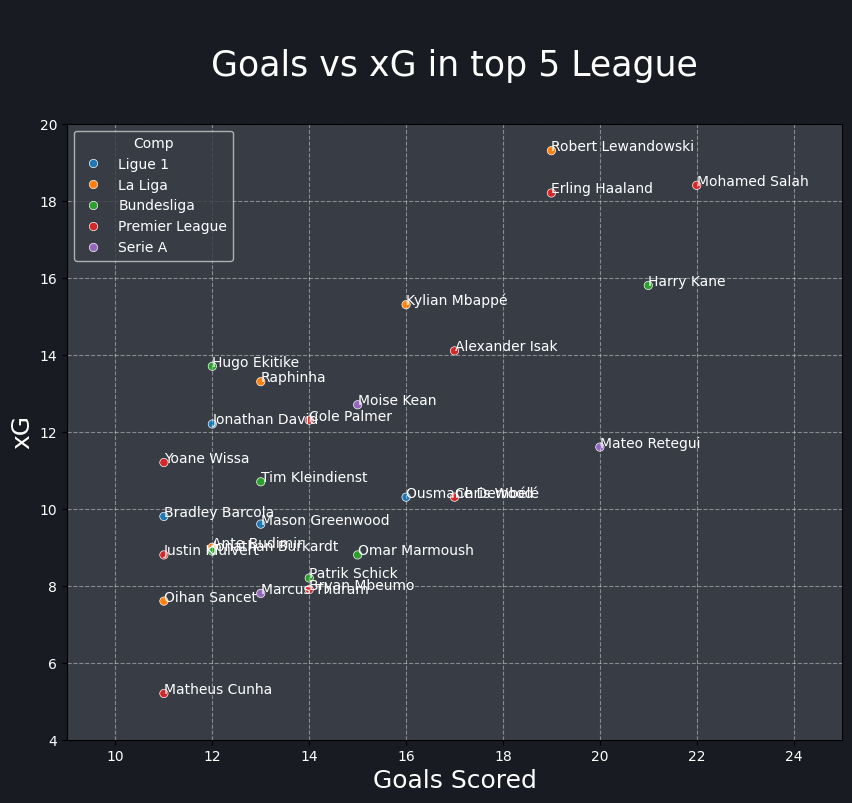

<Figure size 640x480 with 0 Axes>

In [221]:
# Goals and xG
df2=df[df['Gls']>10]
plt.figure(figsize=(10,8))
sns.set_style(rc={'axes.facecolor': '#383d45', 'figure.facecolor': '#181b21','text.color': 'white'})
sns.scatterplot(data=df2,x=df2['Gls'],y=df2['xG'],hue=df2['Comp'])
plt.title("\nGoals vs xG in top 5 League\n",fontsize=25)
plt.grid(alpha=0.4,linestyle='--',color='#ffffff')
plt.xlim(9,25)
plt.ylim(4,20)
plt.xlabel("Goals Scored",fontsize=18,color='white')
plt.ylabel("xG",fontsize=18,color='white')
for x in range(df2.shape[0]):
    plt.text(df2['Gls'].values[x],df2['xG'].values[x],df2['Player'].values[x])
plt.tick_params(axis='x', labelcolor='white')
plt.tick_params(axis='y', labelcolor='white')
plt.show()
plt.savefig("GoalsvsxG.jpg")

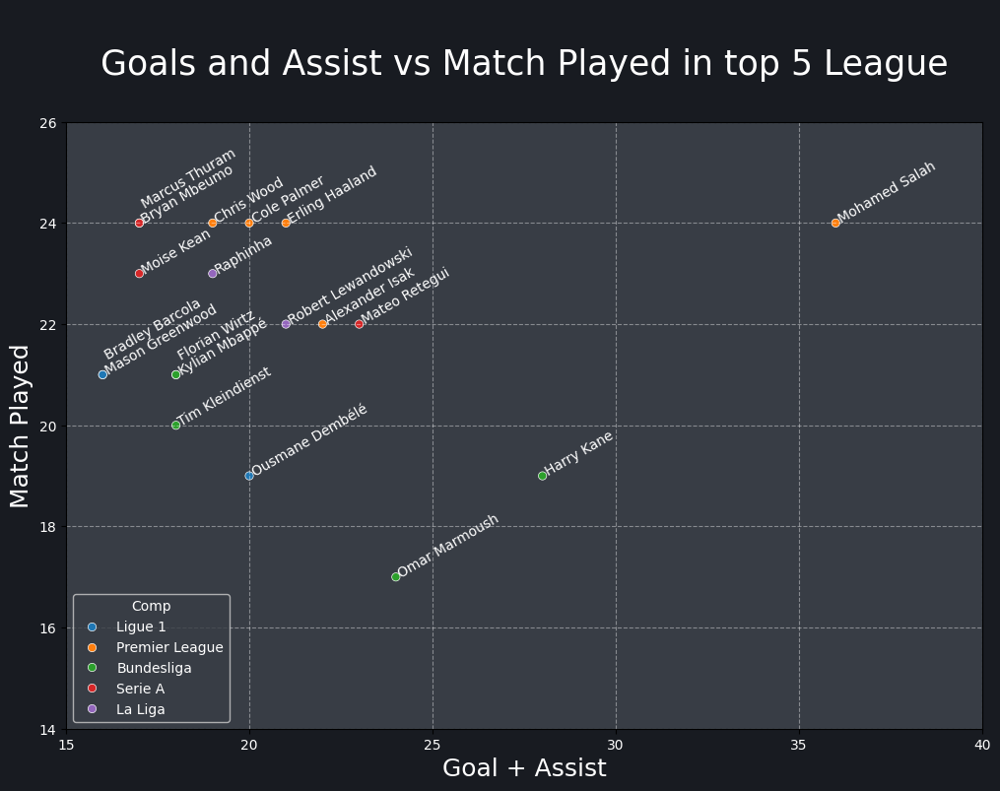

<Figure size 640x480 with 0 Axes>

In [220]:
#G+A and MP
df3=df[df['G+A']>15]
plt.figure(figsize=(12,8))
sns.set_style(rc={'axes.facecolor': '#383d45', 'figure.facecolor': '#181b21','text.color': 'white'})
sns.scatterplot(data=df3,x=df3['G+A'],y=df3['MP'],hue=df3['Comp'])
plt.title("\nGoals and Assist vs Match Played in top 5 League\n",fontsize=25)
plt.grid(alpha=0.4,linestyle='--',color='#ffffff')
plt.xlim(15,40)
plt.ylim(14,26)
plt.xlabel("Goal + Assist",fontsize=18,color='white')
plt.ylabel("Match Played",fontsize=18,color='white')
for x in range(df3.shape[0]):
    if (df3['Player'].values[x]=='Marcus Thuram')  or (df3['Player'].values[x]=='Bradley Barcola') or (df3['Player'].values[x]=='Florian Wirtz'):
        plt.text(df3['G+A'].values[x],df3['MP'].values[x]+0.3,df3['Player'].values[x],rotation=30)
        continue

    plt.text(df3['G+A'].values[x],df3['MP'].values[x],df3['Player'].values[x],rotation=30)
plt.tick_params(axis='x', labelcolor='white')
plt.tick_params(axis='y', labelcolor='white')
plt.show()
plt.savefig("GAvsMP.jpg")

In [214]:
df3[df3['MP']==21][['MP','Player','G+A']]

,MP,Player,G+A
226,21,Bradley Barcola,16
976,21,Mason Greenwood,16
1570,21,Kylian Mbappé,18
2585,21,Florian Wirtz,18
